
Processing SBT001
Loading data...
Original data:


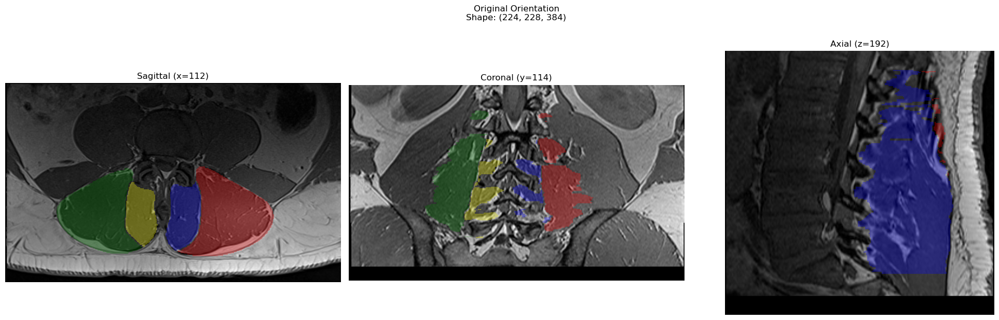


Checking orientation...

1. Trying Original


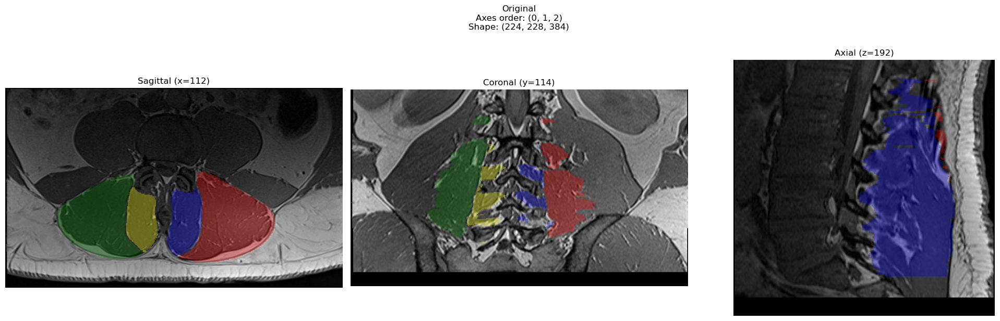


2. Trying Reorder: 1,0,2


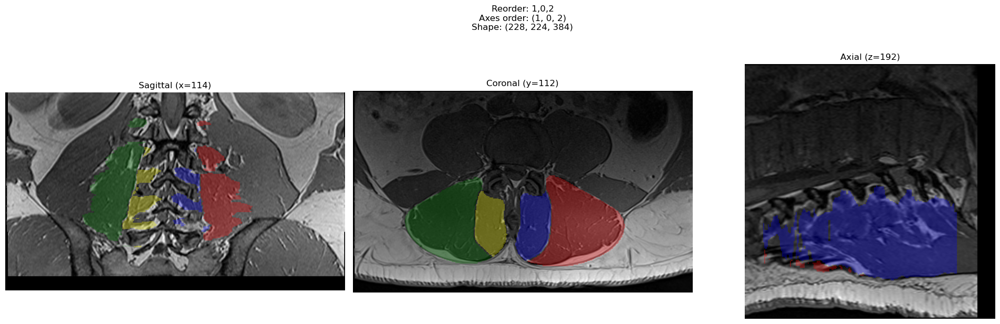


3. Trying Reorder: 1,2,0


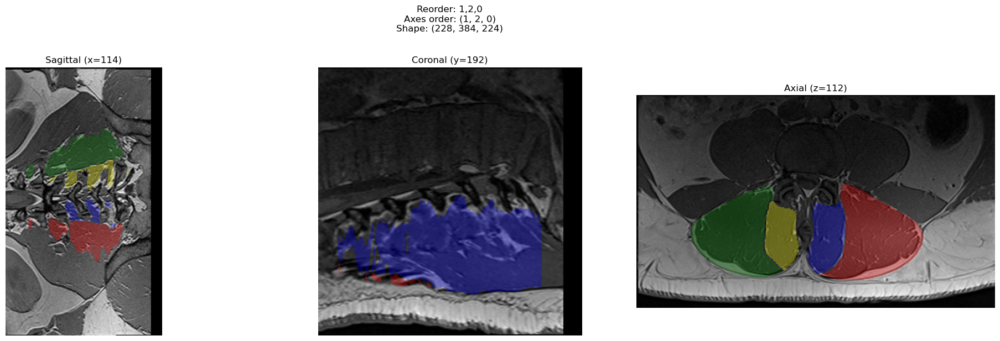


4. Trying Reorder: 2,0,1


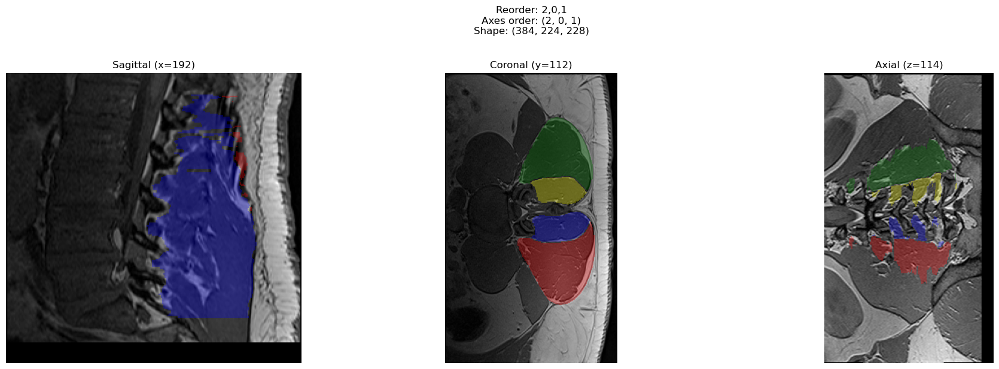


5. Trying Reorder: 2,1,0


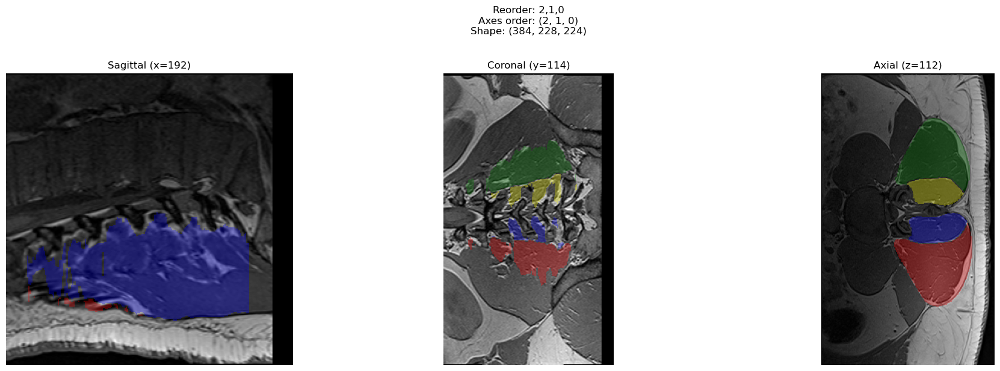


Verifying orientation...


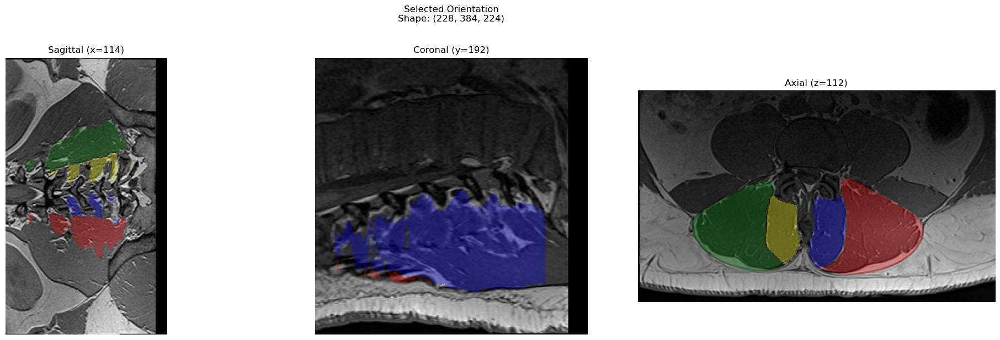


Processing to HDF5...
Skipping slice 0 - missing some masks
Processed slice 11/224
Processed slice 21/224
Processed slice 31/224
Processed slice 41/224
Processed slice 51/224
Processed slice 61/224
Processed slice 71/224
Processed slice 81/224
Processed slice 91/224
Processed slice 101/224
Processed slice 111/224
Processed slice 121/224
Processed slice 131/224
Processed slice 141/224
Processed slice 151/224
Processed slice 161/224
Processed slice 171/224
Processed slice 181/224
Skipping slice 190 - missing some masks
Skipping slice 200 - missing some masks
Skipping slice 210 - missing some masks
Skipping slice 220 - missing some masks

Verifying HDF5 data...


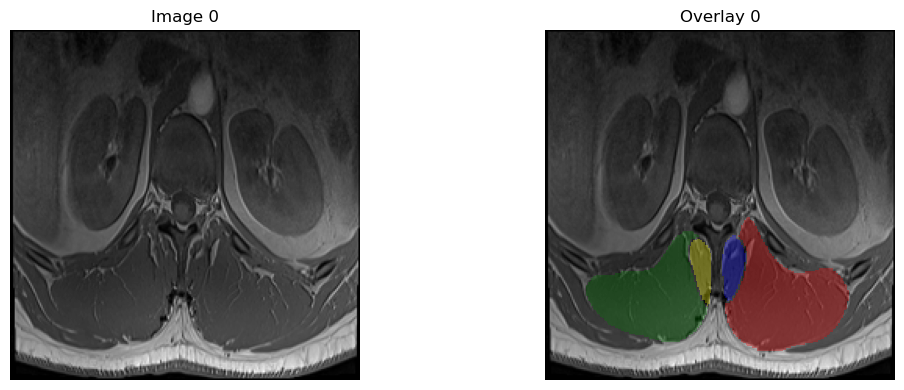

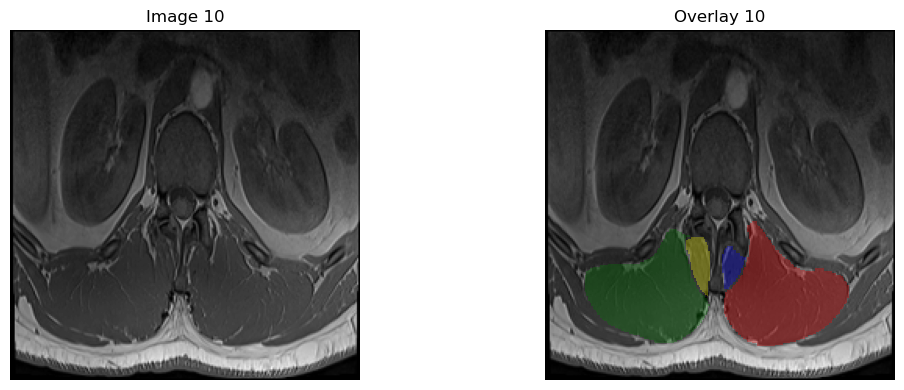

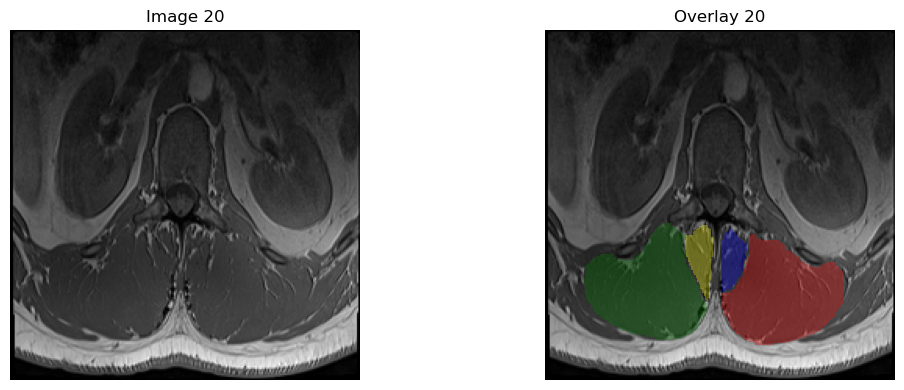

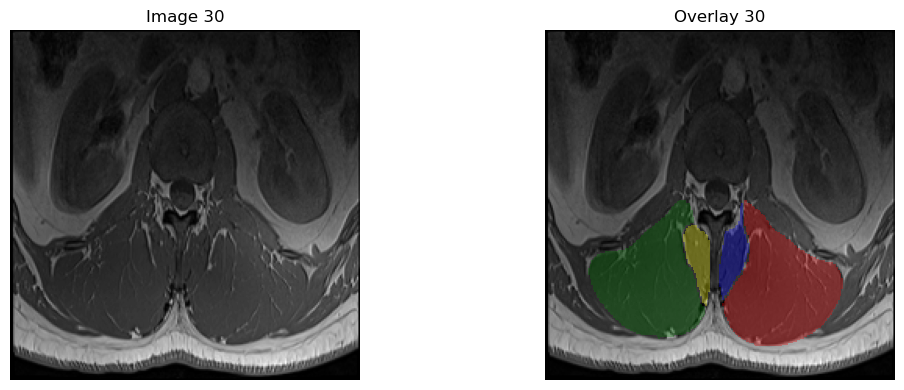

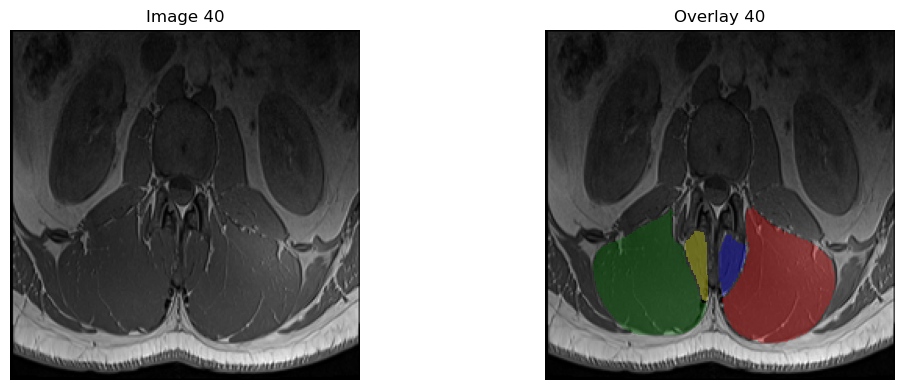

...

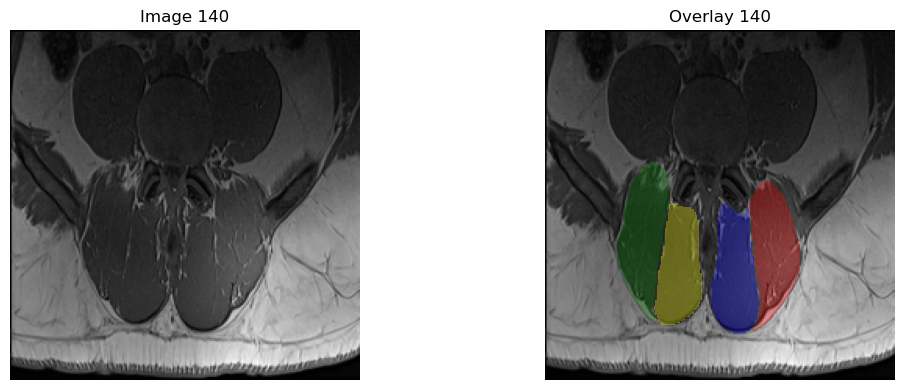

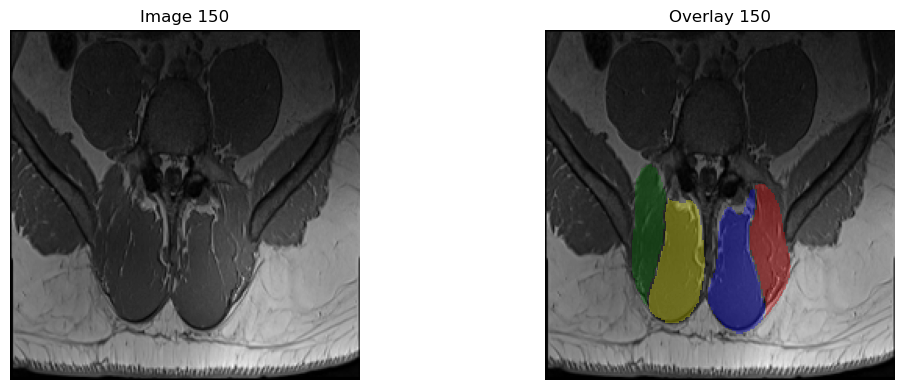

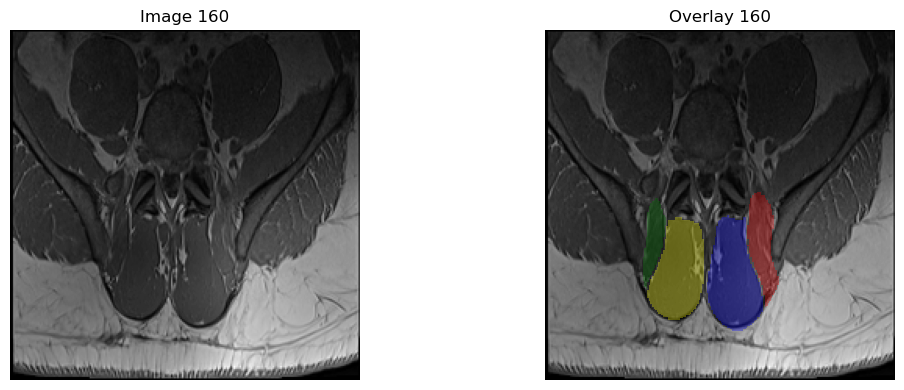

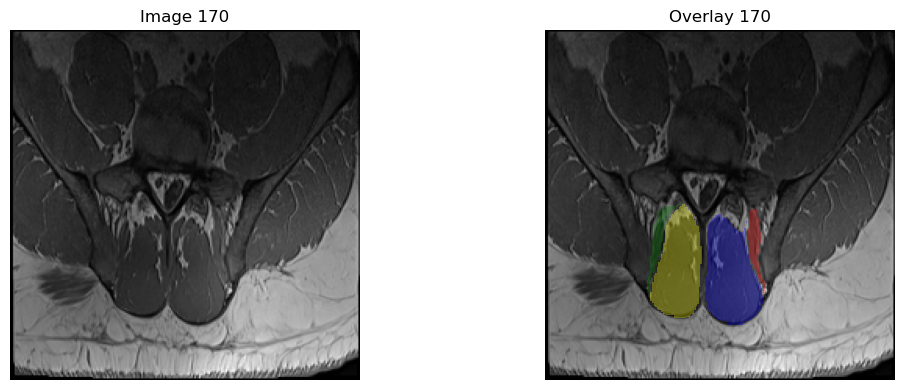

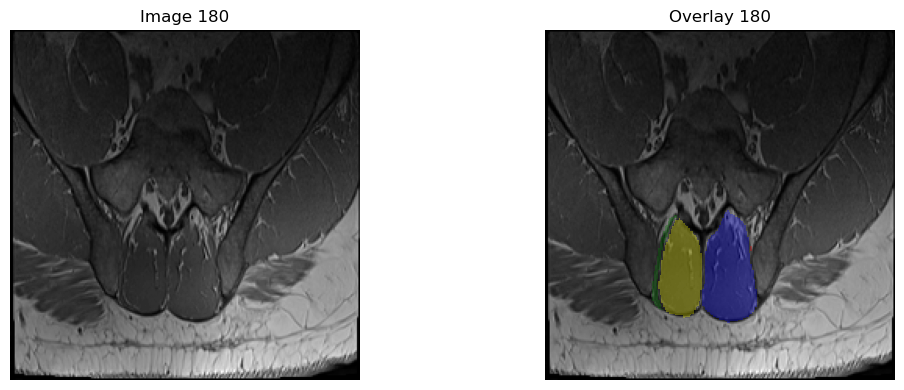


Processing SBT002
Loading data...
Original data:


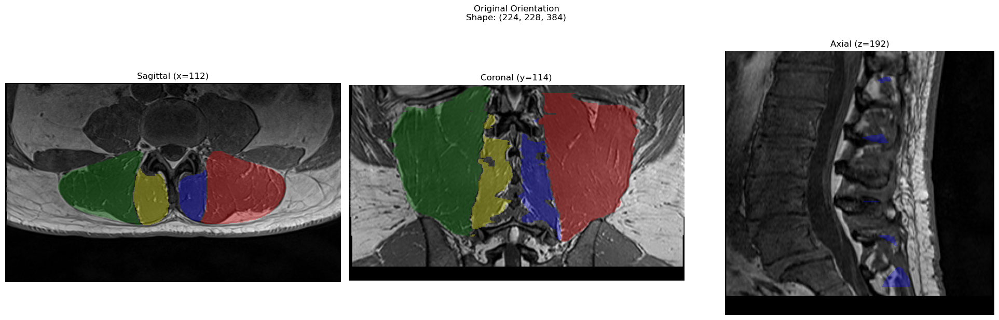


Checking orientation...

1. Trying Original


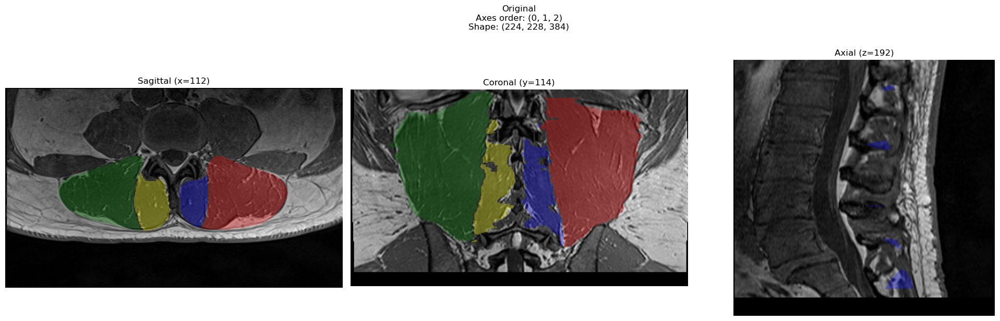


2. Trying Reorder: 1,0,2


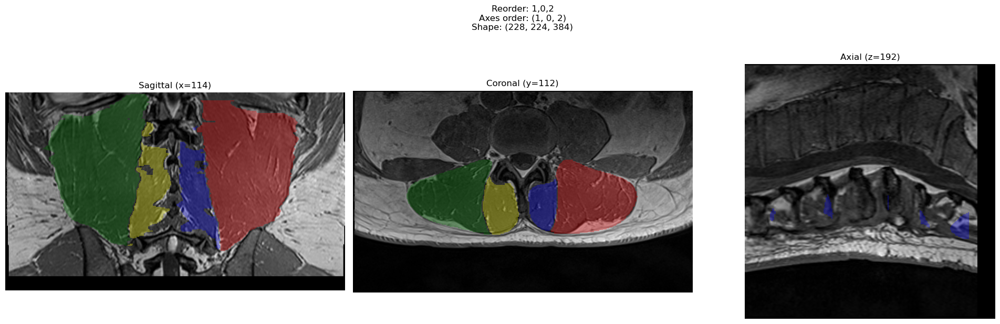


3. Trying Reorder: 1,2,0


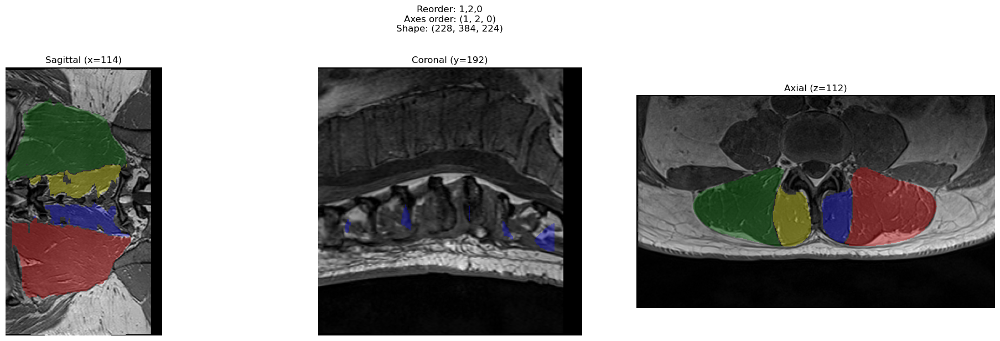


4. Trying Reorder: 2,0,1


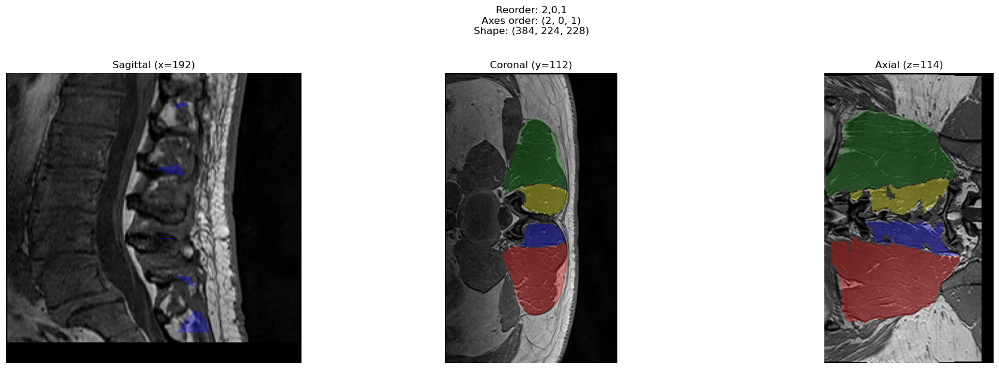


5. Trying Reorder: 2,1,0


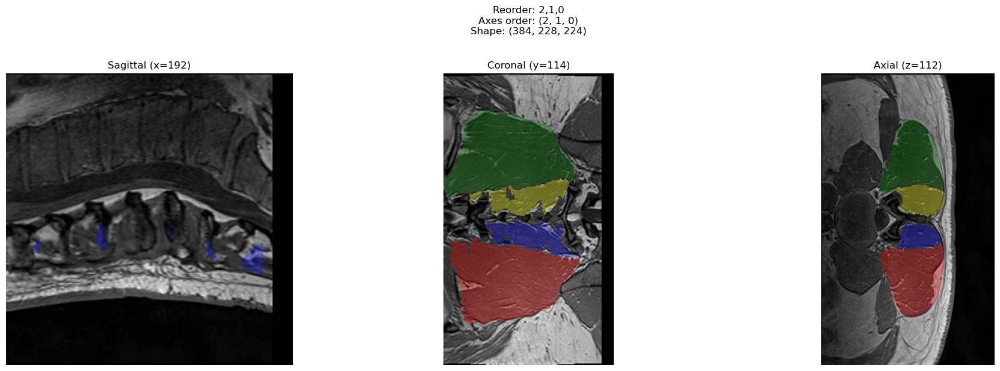


Verifying orientation...


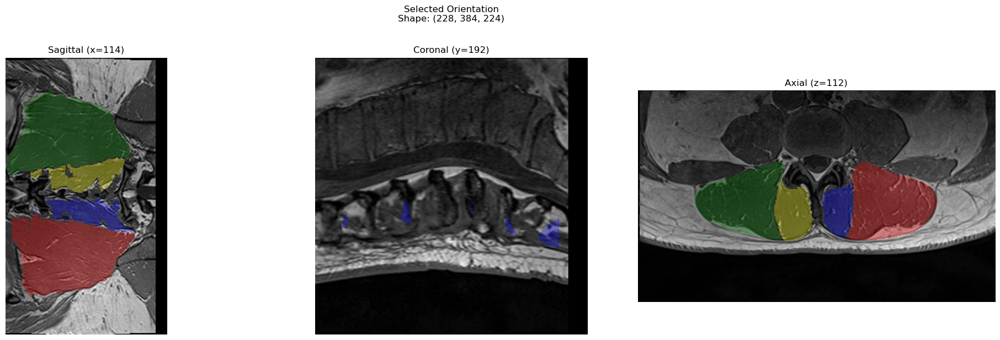


Processing to HDF5...
Skipping slice 0 - missing some masks
Processed slice 11/224
Processed slice 21/224
Processed slice 31/224
Processed slice 41/224
Processed slice 51/224
Processed slice 61/224
Processed slice 71/224
Processed slice 81/224
Processed slice 91/224
Processed slice 101/224
Processed slice 111/224
Processed slice 121/224
Processed slice 131/224
Processed slice 141/224
Processed slice 151/224
Processed slice 161/224
Processed slice 171/224
Processed slice 181/224
Processed slice 191/224
Skipping slice 200 - missing some masks
Skipping slice 210 - missing some masks
Skipping slice 220 - missing some masks

Verifying HDF5 data...


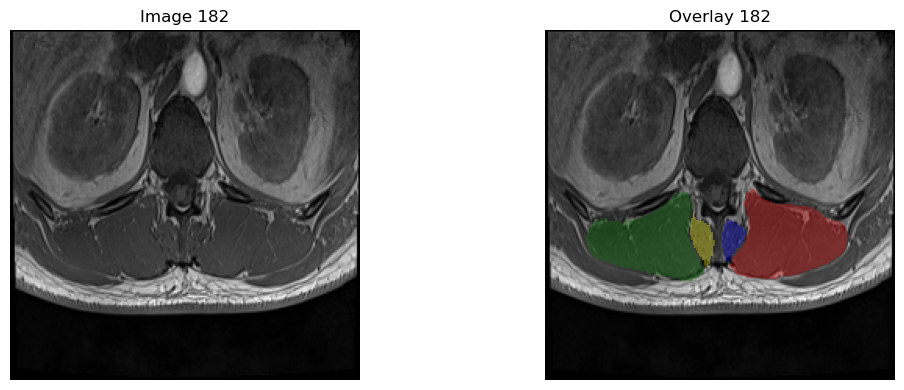

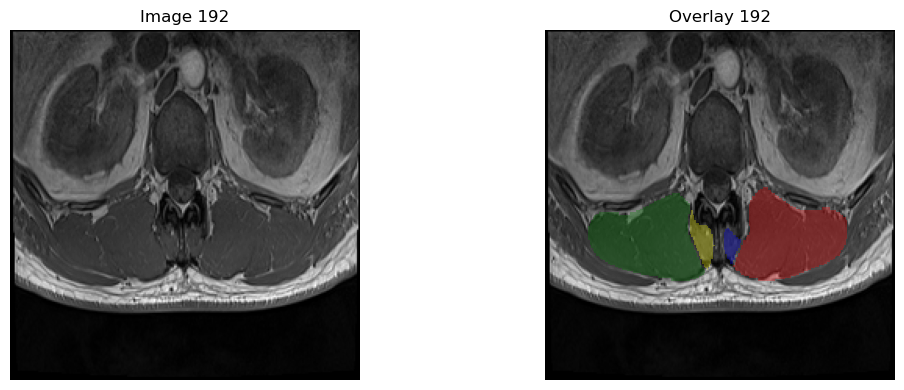

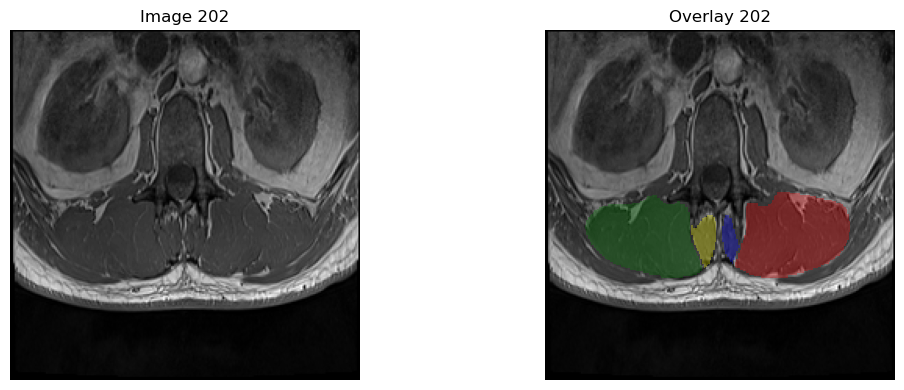

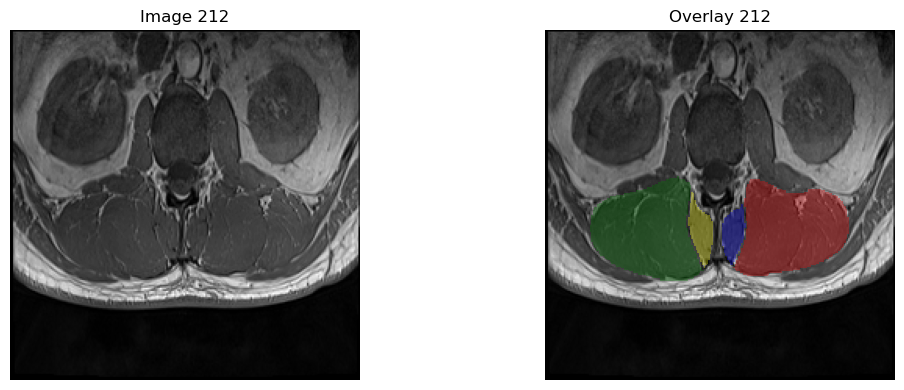

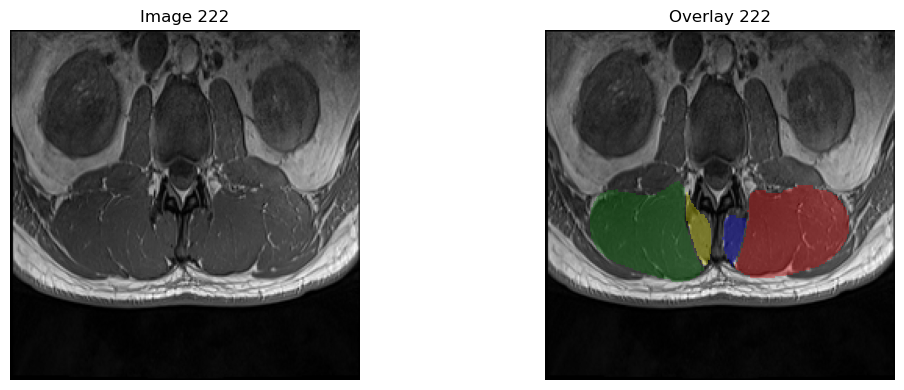

...

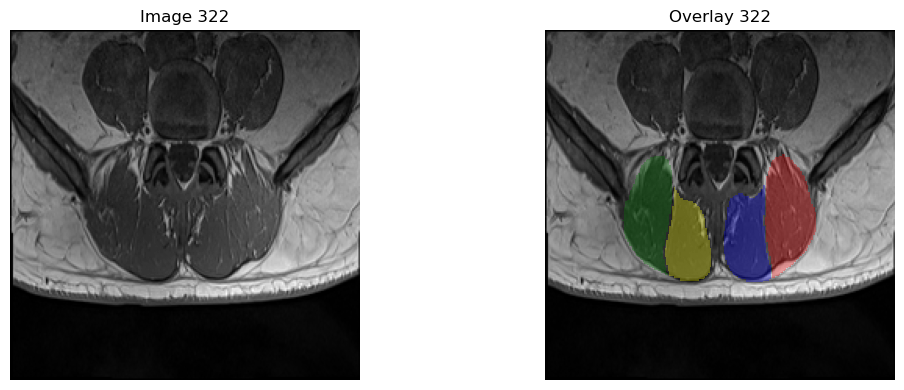

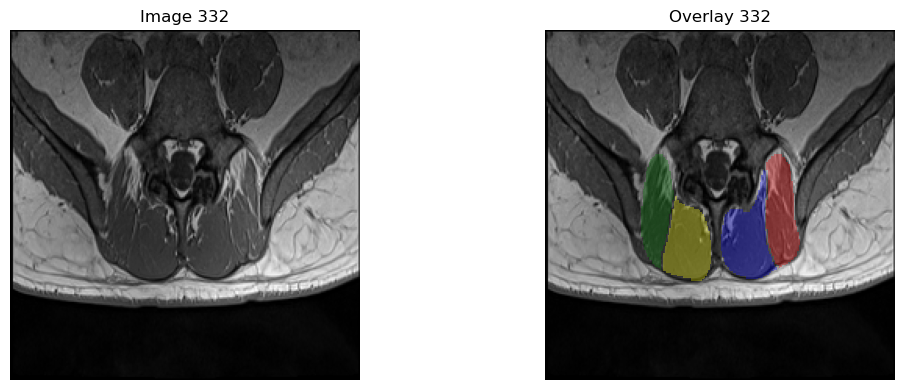

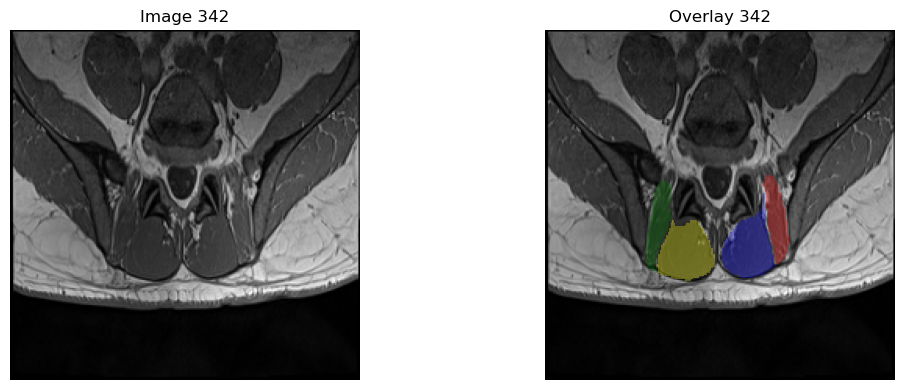

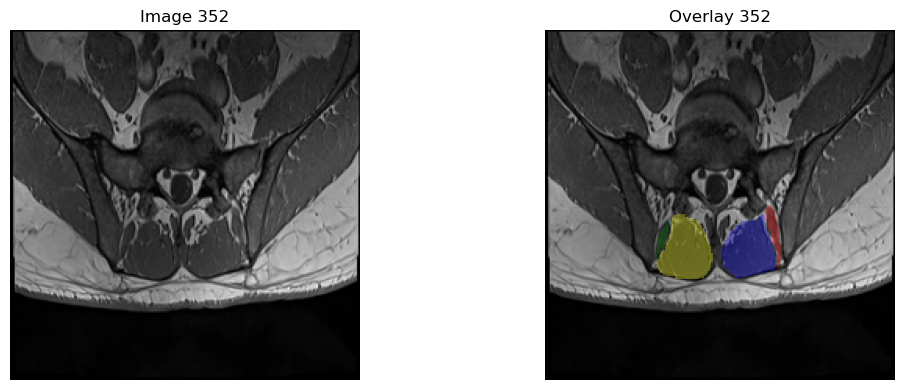

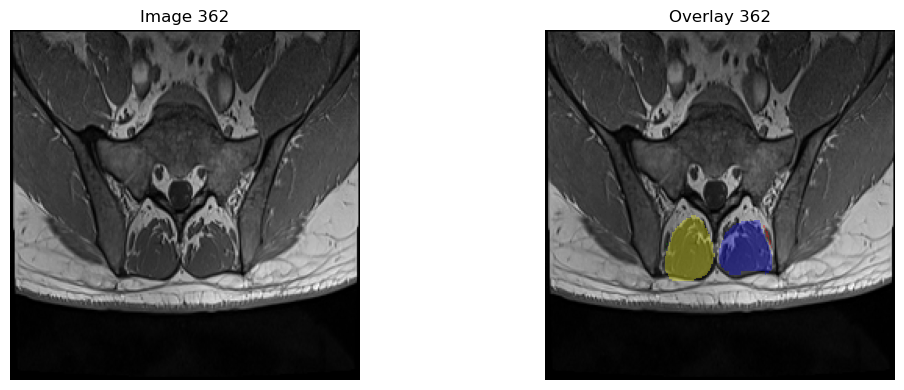


Processing SBT094
Loading data...
Original data:


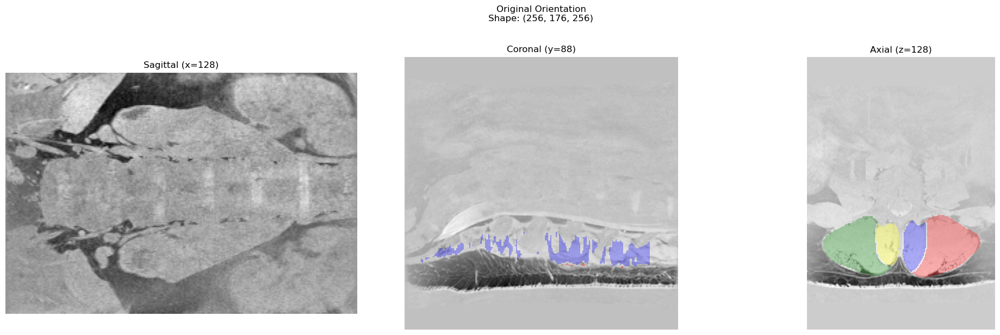


Checking orientation...

1. Trying Original


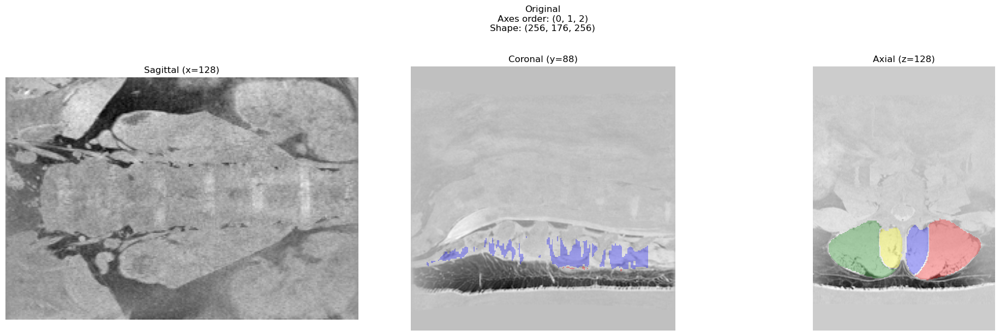


2. Trying Reorder: 1,0,2


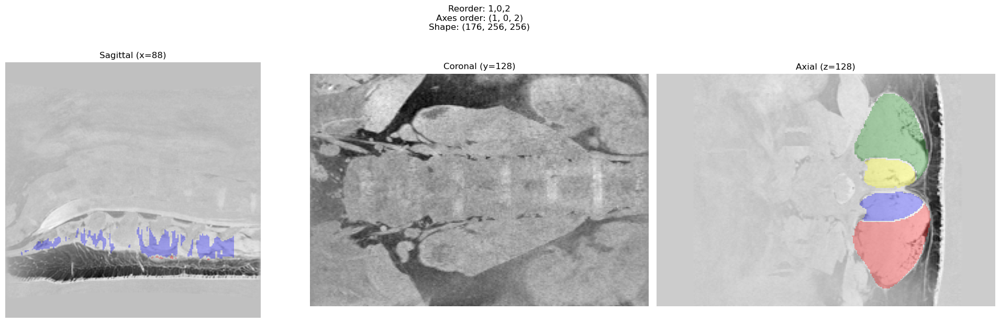


3. Trying Reorder: 1,2,0


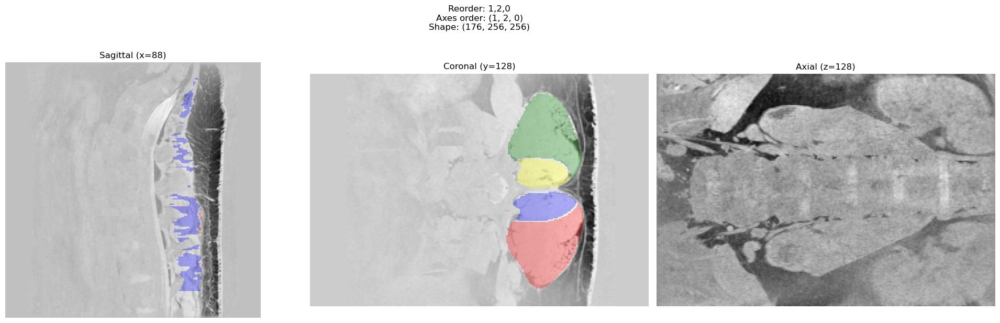


4. Trying Reorder: 2,0,1


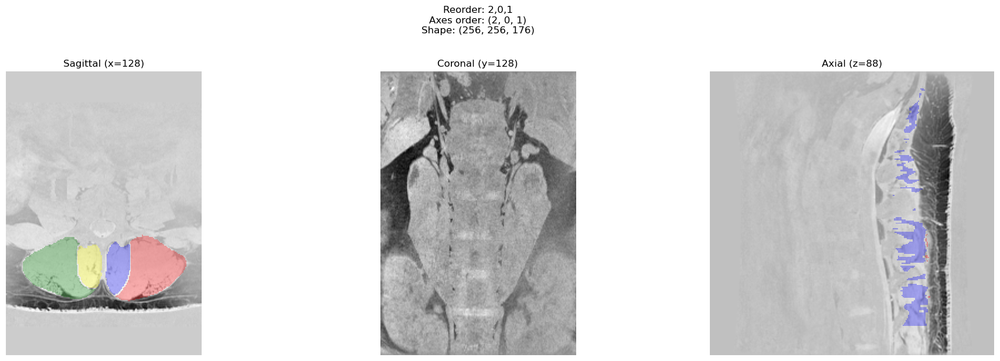


5. Trying Reorder: 2,1,0


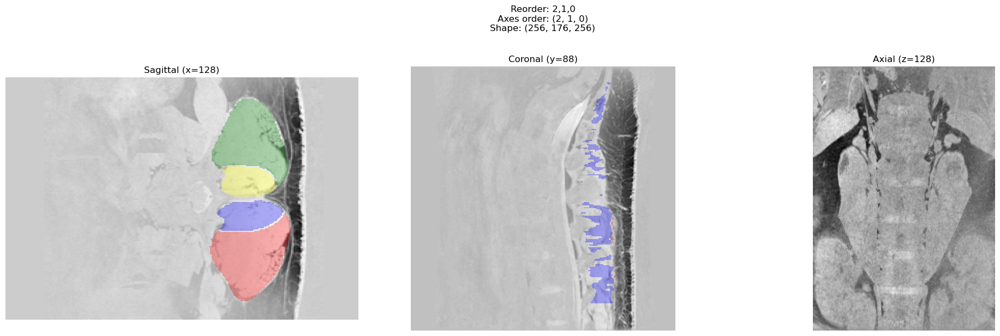


Verifying orientation...


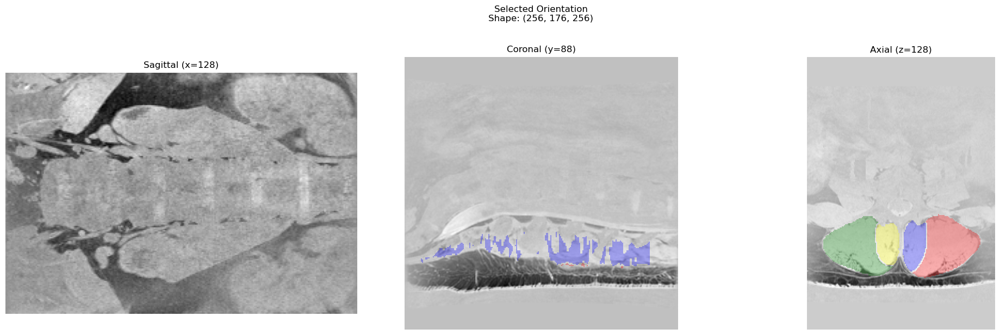


Processing to HDF5...
Skipping slice 0 - missing some masks
Skipping slice 10 - missing some masks
Processed slice 21/256
Processed slice 31/256
Processed slice 41/256
Processed slice 51/256
Processed slice 61/256
Processed slice 71/256
Processed slice 81/256
Processed slice 91/256
Processed slice 101/256
Processed slice 111/256
Processed slice 121/256
Processed slice 131/256
Processed slice 141/256
Processed slice 151/256
Processed slice 161/256
Processed slice 171/256
Processed slice 181/256
Processed slice 191/256
Processed slice 201/256
Processed slice 211/256
Processed slice 221/256
Skipping slice 230 - missing some masks
Skipping slice 240 - missing some masks
Skipping slice 250 - missing some masks

Verifying HDF5 data...


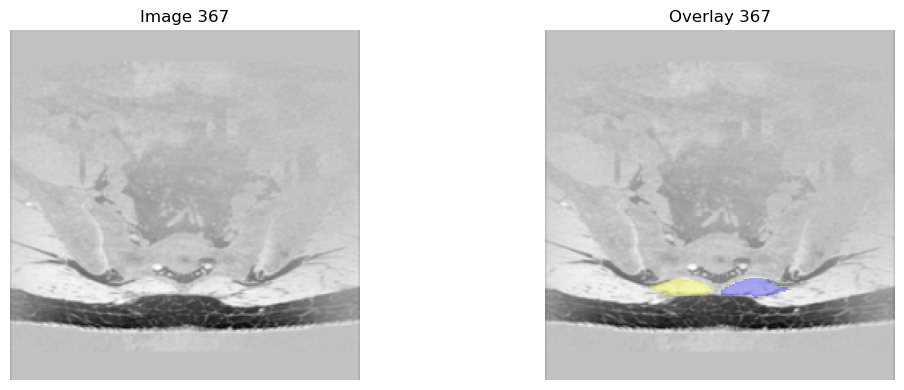

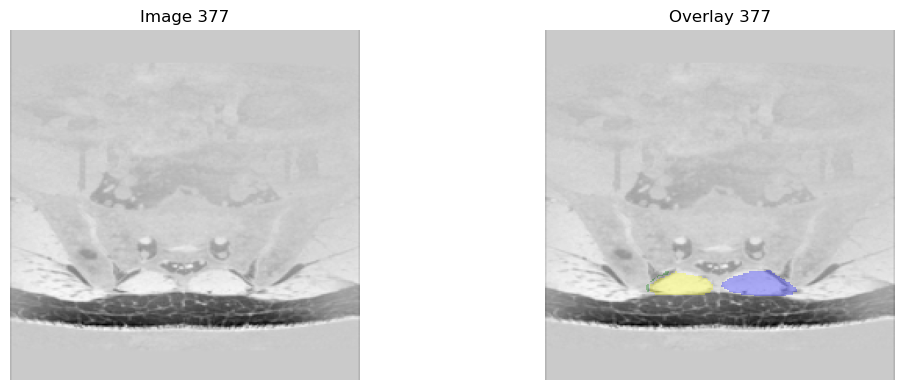

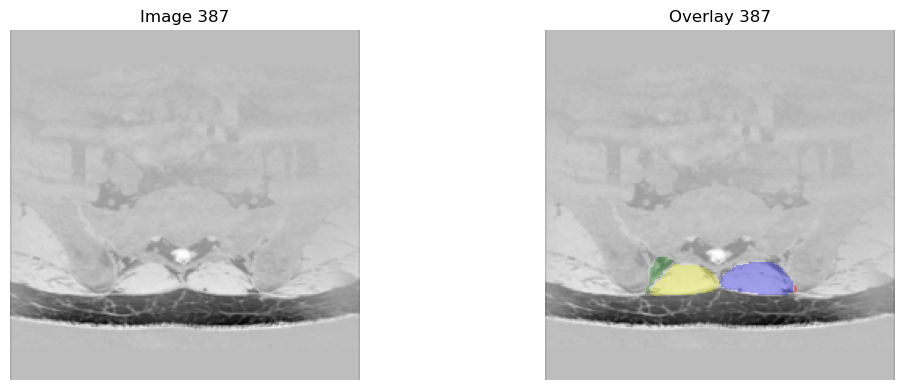

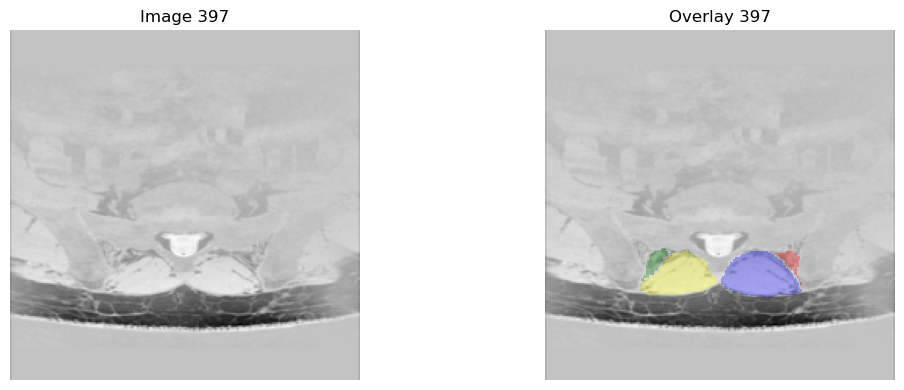

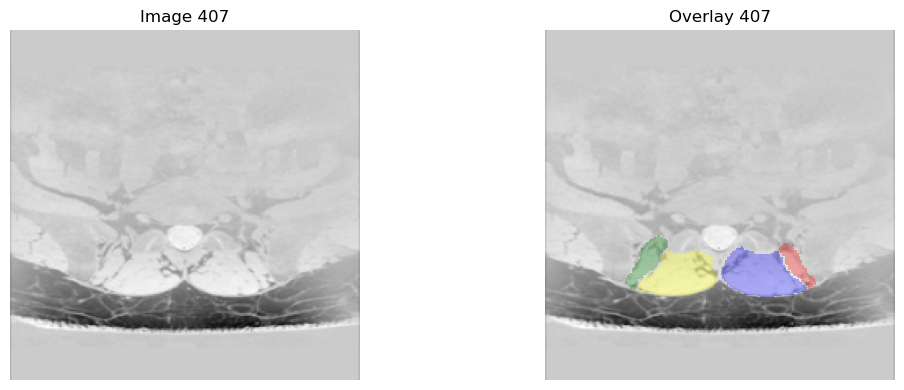

...

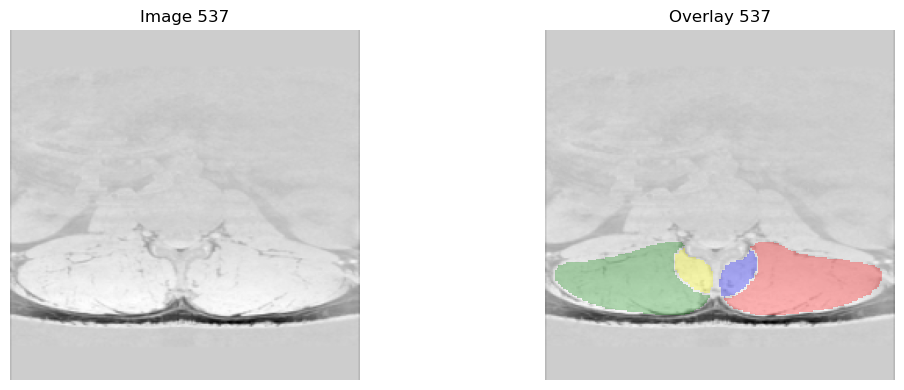

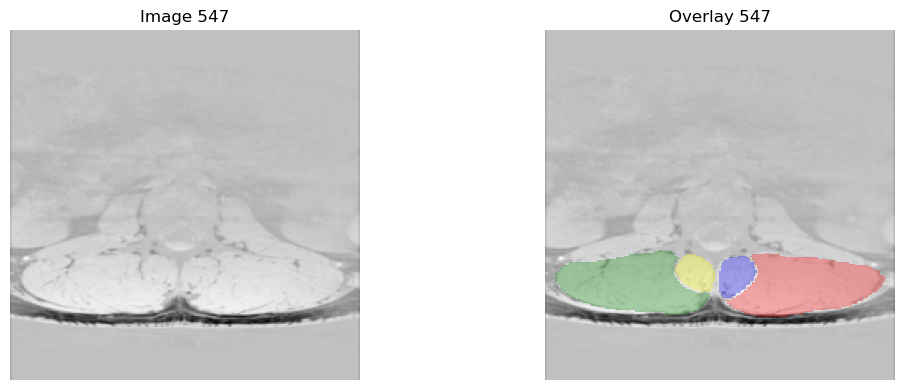

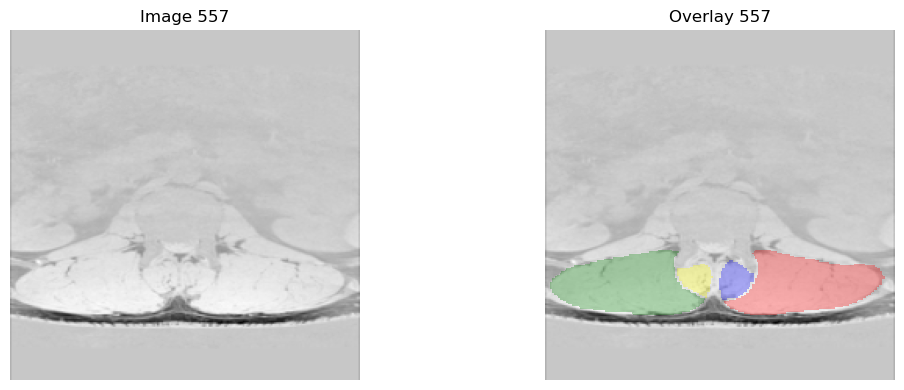

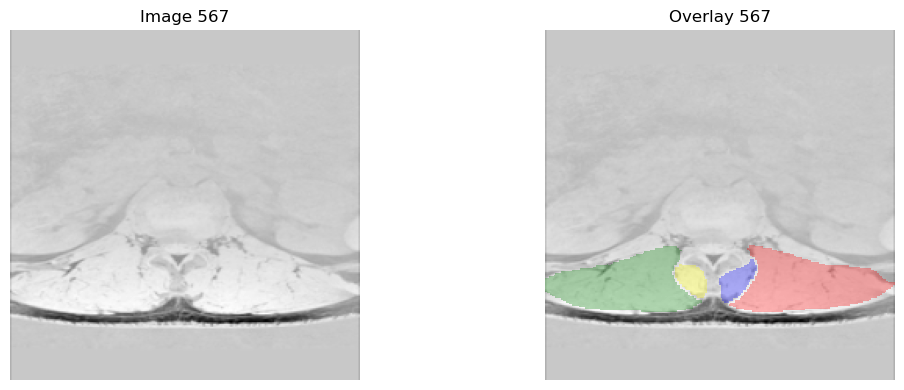

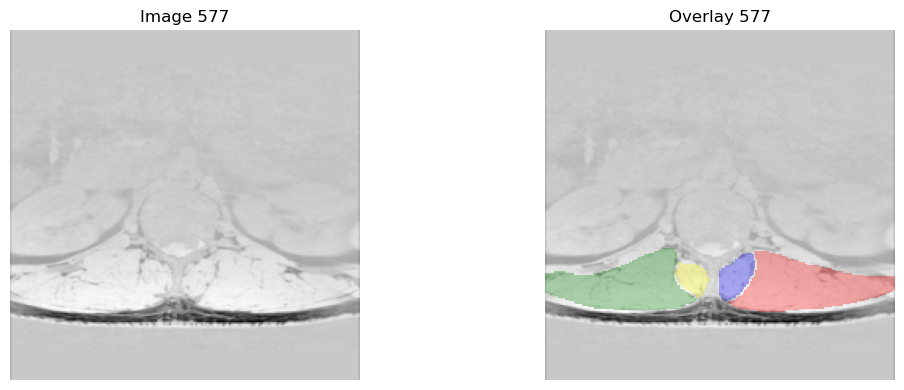


Processing SBT095
Loading data...
Original data:


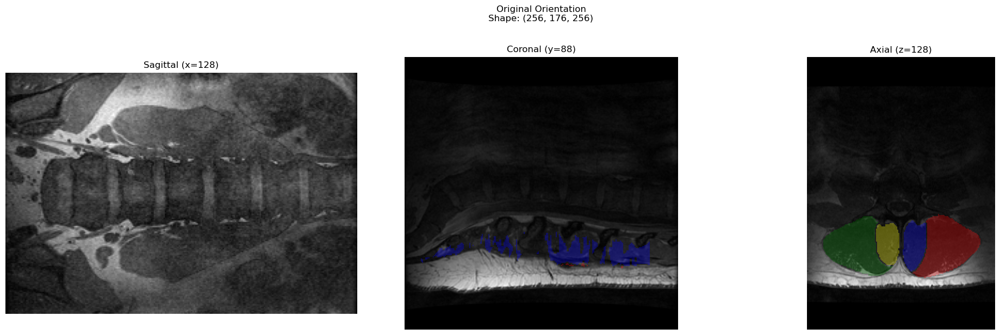


Checking orientation...

1. Trying Original


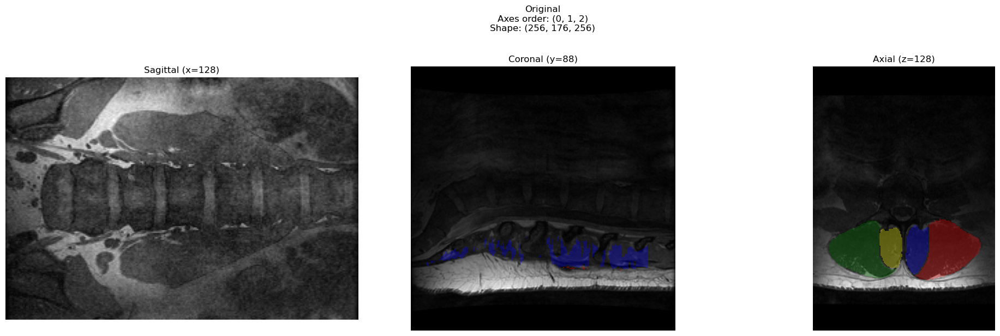


2. Trying Reorder: 1,0,2


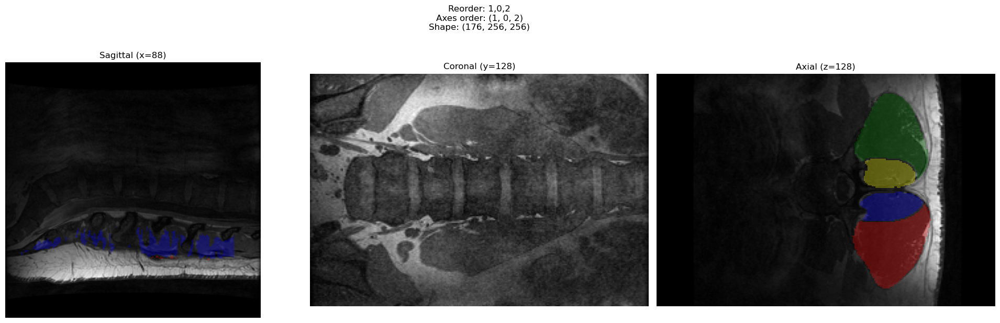


3. Trying Reorder: 1,2,0


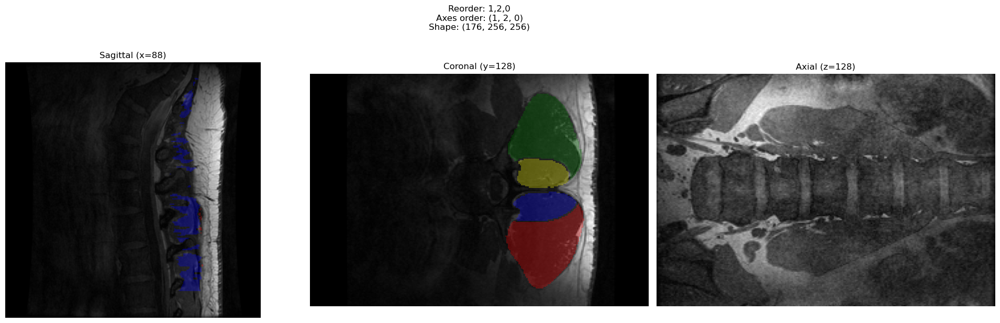


4. Trying Reorder: 2,0,1


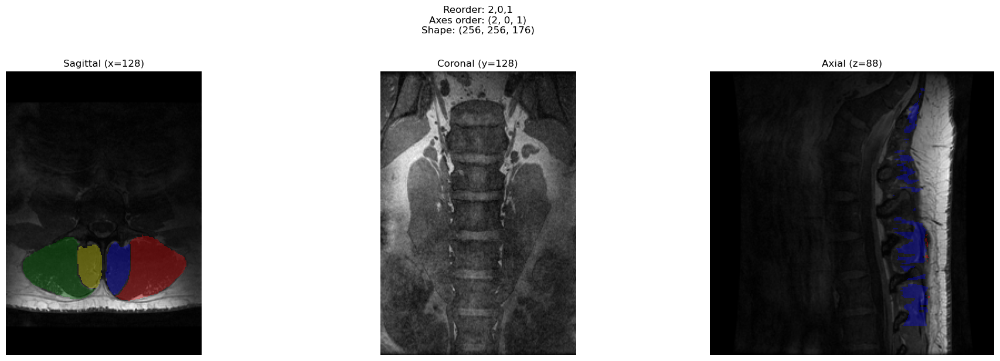


5. Trying Reorder: 2,1,0


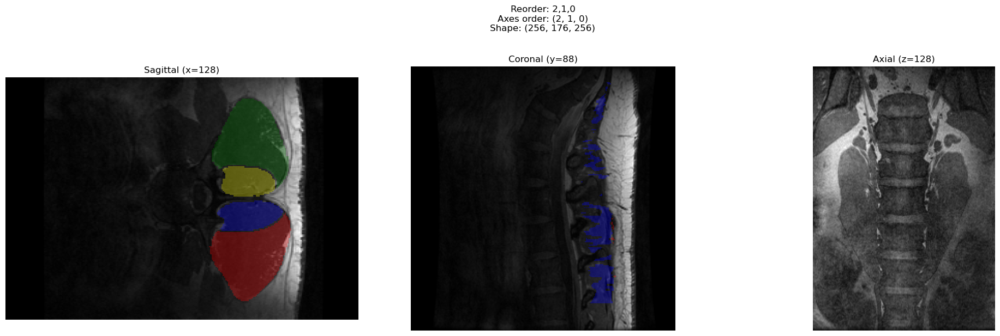


Verifying orientation...


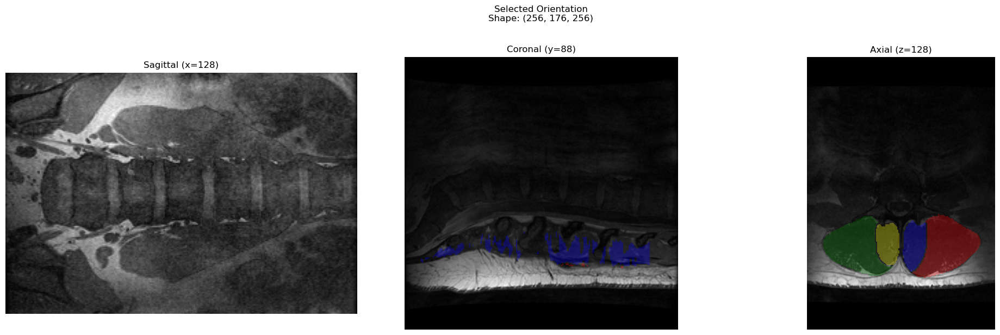


Processing to HDF5...
Skipping slice 0 - missing some masks
Skipping slice 10 - missing some masks
Processed slice 21/256
Processed slice 31/256
Processed slice 41/256
Processed slice 51/256
Processed slice 61/256
Processed slice 71/256
Processed slice 81/256
Processed slice 91/256
Processed slice 101/256
Processed slice 111/256
Processed slice 121/256
Processed slice 131/256
Processed slice 141/256
Processed slice 151/256
Processed slice 161/256
Processed slice 171/256
Processed slice 181/256
Processed slice 191/256
Processed slice 201/256
Processed slice 211/256
Processed slice 221/256
Skipping slice 230 - missing some masks
Skipping slice 240 - missing some masks
Skipping slice 250 - missing some masks

Verifying HDF5 data...


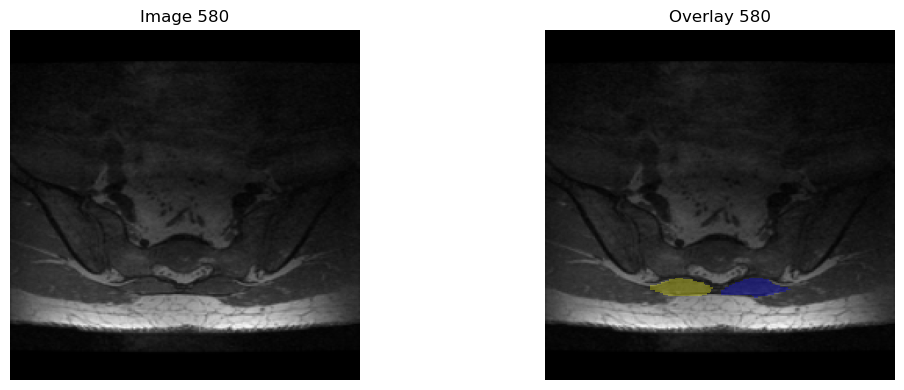

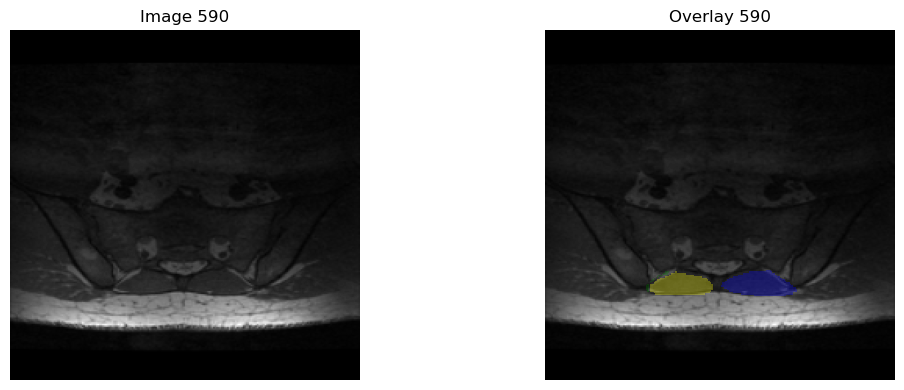

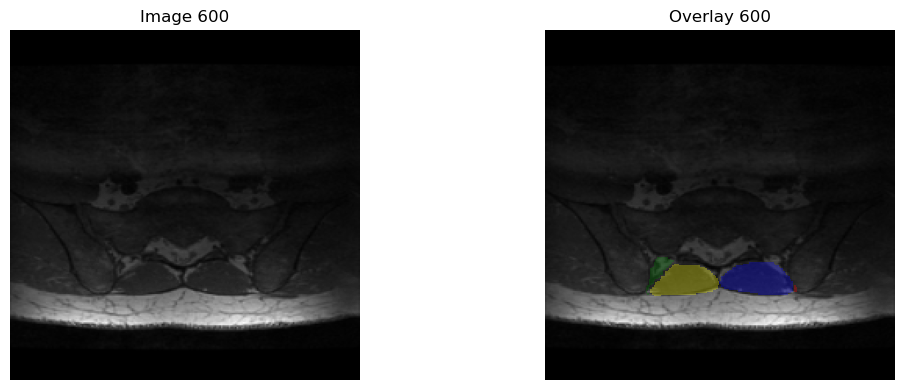

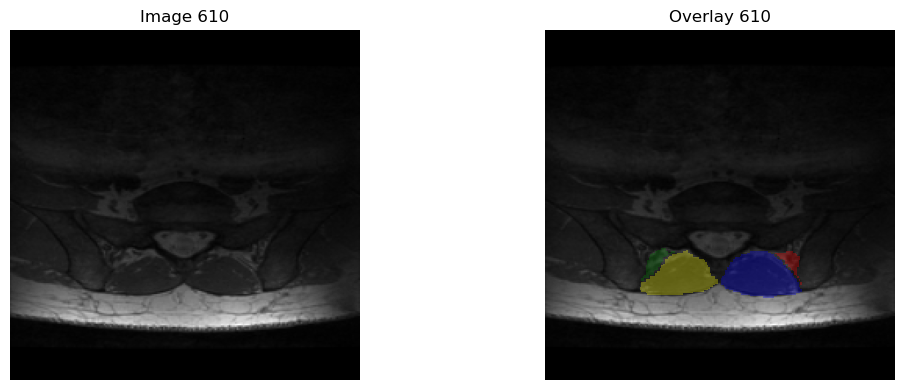

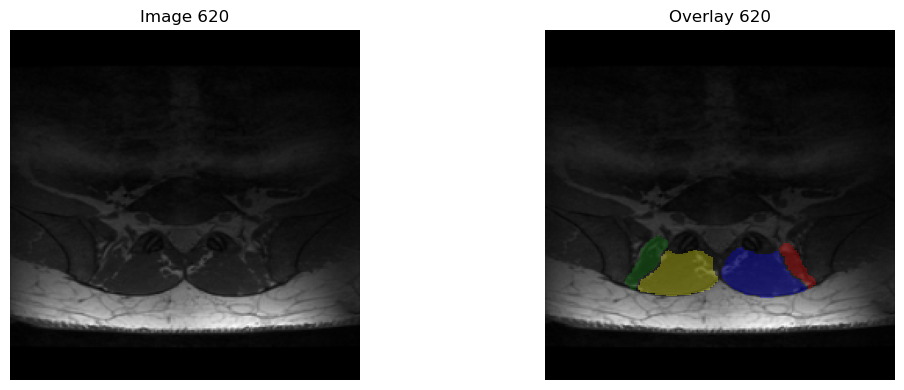

...

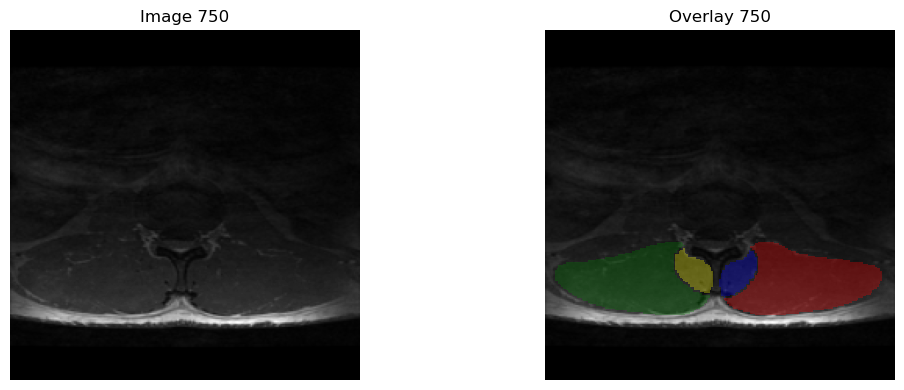

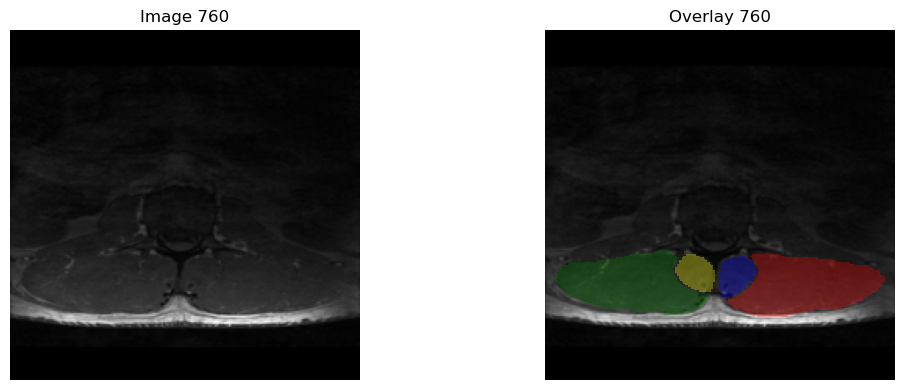

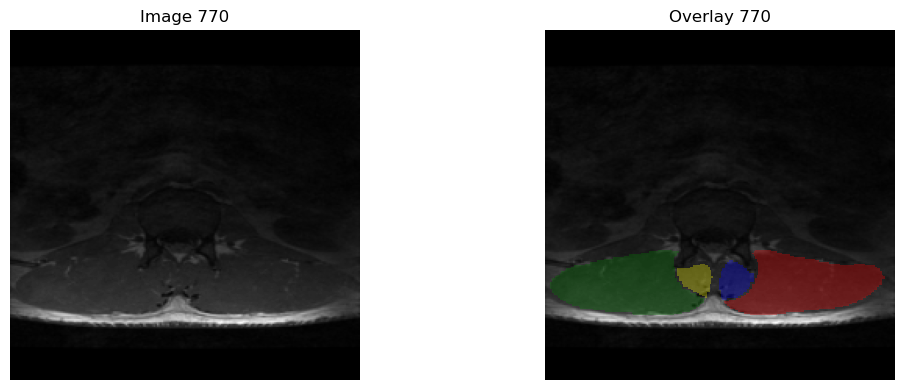

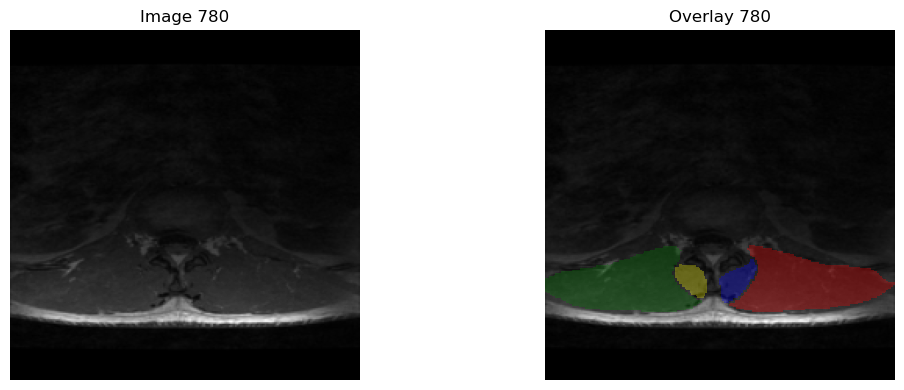

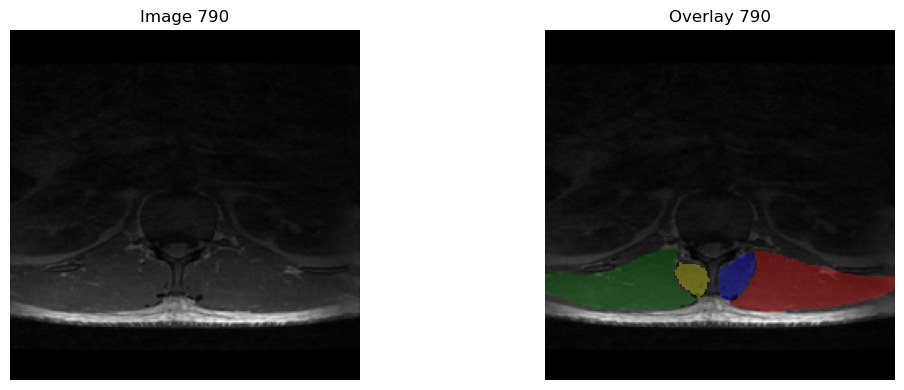

In [3]:
import os
import numpy as np
import nibabel as nib
from nibabel.orientations import aff2axcodes
import matplotlib.pyplot as plt
import h5py
from skimage.transform import resize

def load_nifti_file(file_path):
    """Load a NIFTI file and return its data and orientation info."""
    img = nib.load(file_path)
    data = img.get_fdata()
    orientation = aff2axcodes(img.affine)
    return data, orientation, img.affine

def view_three_planes(data, masks=None, title="", slice_indices=None):
    """View sagittal, coronal, and axial planes."""
    if slice_indices is None:
        x_mid = data.shape[0] // 2
        y_mid = data.shape[1] // 2
        z_mid = data.shape[2] // 2
        slice_indices = (x_mid, y_mid, z_mid)
    else:
        x_mid, y_mid, z_mid = slice_indices

    fig, axes = plt.subplots(1, 3, figsize=(20, 6))
    plt.suptitle(f'{title}\nShape: {data.shape}', y=1.02, fontsize=12)

    # Sagittal view
    axes[0].imshow(data[x_mid, :, :], cmap='gray')
    if masks is not None:
        for mask_idx, mask in enumerate(masks):
            color = ['red', 'blue', 'green', 'yellow'][mask_idx % 4]
            mask_overlay = np.ma.masked_where(mask[x_mid, :, :] < 0.5, mask[x_mid, :, :])
            axes[0].imshow(mask_overlay, alpha=0.3, cmap=plt.cm.colors.ListedColormap([color]))
    axes[0].set_title(f'Sagittal (x={x_mid})')
    axes[0].axis('off')

    # Coronal view
    axes[1].imshow(data[:, y_mid, :], cmap='gray')
    if masks is not None:
        for mask_idx, mask in enumerate(masks):
            color = ['red', 'blue', 'green', 'yellow'][mask_idx % 4]
            mask_overlay = np.ma.masked_where(mask[:, y_mid, :] < 0.5, mask[:, y_mid, :])
            axes[1].imshow(mask_overlay, alpha=0.3, cmap=plt.cm.colors.ListedColormap([color]))
    axes[1].set_title(f'Coronal (y={y_mid})')
    axes[1].axis('off')

    # Axial view
    axes[2].imshow(data[:, :, z_mid], cmap='gray')
    if masks is not None:
        for mask_idx, mask in enumerate(masks):
            color = ['red', 'blue', 'green', 'yellow'][mask_idx % 4]
            mask_overlay = np.ma.masked_where(mask[:, :, z_mid] < 0.5, mask[:, :, z_mid])
            axes[2].imshow(mask_overlay, alpha=0.3, cmap=plt.cm.colors.ListedColormap([color]))
    axes[2].set_title(f'Axial (z={z_mid})')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

def try_orientations(data, masks=None):
    """Try different axis orientations and let user choose the correct one."""
    reorientations = [
        ("Original", lambda x: x, (0,1,2)),
        ("Reorder: 1,0,2", lambda x: np.transpose(x, (1,0,2)), (1,0,2)),
        ("Reorder: 1,2,0", lambda x: np.transpose(x, (1,2,0)), (1,2,0)),
        ("Reorder: 2,0,1", lambda x: np.transpose(x, (2,0,1)), (2,0,1)),
        ("Reorder: 2,1,0", lambda x: np.transpose(x, (2,1,0)), (2,1,0))
    ]

    for idx, (name, transform_func, axes_order) in enumerate(reorientations, 1):
        print(f"\n{idx}. Trying {name}")
        transformed_data = transform_func(data)
        transformed_masks = [transform_func(mask) for mask in masks] if masks else None
        
        view_three_planes(transformed_data, transformed_masks, 
                         f"{name}\nAxes order: {axes_order}")

    while True:
        try:
            choice = int(input("\nSelect the orientation that shows correct anatomical planes (1-5): "))
            if 1 <= choice <= len(reorientations):
                return reorientations[choice-1][1], reorientations[choice-1][2]
        except ValueError:
            pass
        print("Invalid choice. Please enter a number between 1 and 5.")

def normalize_data(data):
    """Normalize data to [0, 1] range."""
    data = data - data.min()
    return data / (data.max() + 1e-8)

def resize_slice(data, target_size=(224, 224)):
    """Resize a 2D slice to target size."""
    return resize(data, target_size, mode='constant', anti_aliasing=True, preserve_range=True)

def process_to_h5(image_data, masks, output_path, subject_id):
    """Process and save data to HDF5 format. Skip slices without any mask data."""
    with h5py.File(output_path, 'a') as f:
        # Get the next available index
        existing_keys = [k for k in f.keys() if k.startswith('image_')]
        start_idx = len(existing_keys)
        curr_idx = start_idx

        # Process each slice
        num_slices = image_data.shape[2]
        for slice_idx in range(num_slices):
            # Check if the slice has all four masks
            has_all_masks = True
            for mask in masks:
                if not np.any(mask[:, :, slice_idx] > 0.5):  # Assuming mask threshold of 0.5
                    has_all_masks = False
                    break
            
            # Skip slice if it doesn't have all masks
            if not has_all_masks:
                if slice_idx % 10 == 0:
                    print(f"Skipping slice {slice_idx} - missing some masks")
                continue

            # Process image slice
            img_slice = image_data[:, :, slice_idx]
            img_slice = normalize_data(img_slice)
            img_slice = resize_slice(img_slice)
            img_slice = np.expand_dims(img_slice, axis=0)  # Add channel dimension

            # Process mask slices
            mask_slices = []
            for mask in masks:
                mask_slice = mask[:, :, slice_idx]
                mask_slice = resize_slice(mask_slice)
                mask_slices.append(mask_slice)
            mask_slices = np.stack(mask_slices, axis=0)

            # Save to HDF5
            f.create_dataset(f'image_{curr_idx}', data=img_slice)
            f.create_dataset(f'mask_{curr_idx}', data=mask_slices)

            if slice_idx % 10 == 0:
                print(f"Processed slice {slice_idx + 1}/{num_slices}")
            
            curr_idx += 1

        # Return the actual indices used (which may be fewer than the total number of slices)
        return start_idx, curr_idx - 1

def verify_h5_data(h5_path, start_idx, end_idx, step=80):
    """Verify the saved HDF5 data by displaying some slices."""
    with h5py.File(h5_path, 'r') as f:
        indices = range(start_idx, end_idx + 1, step)
        for idx in indices:
            image = f[f'image_{idx}'][()]
            masks = f[f'mask_{idx}'][()]
            
            plt.figure(figsize=(12, 4))
            
            # Show original image
            plt.subplot(121)
            plt.imshow(image[0], cmap='gray')
            plt.title(f'Image {idx}')
            plt.axis('off')
            
            # Show image with mask overlay
            plt.subplot(122)
            plt.imshow(image[0], cmap='gray')
            colors = ['red', 'blue', 'green', 'yellow']
            for mask_idx, mask in enumerate(masks):
                plt.imshow(np.ma.masked_where(mask < 0.5, mask),
                         alpha=0.3, cmap=plt.cm.colors.ListedColormap([colors[mask_idx]]))
            plt.title(f'Overlay {idx}')
            plt.axis('off')
            
            plt.tight_layout()
            plt.show()

def main():
    # Paths
    base_dir = "/Volumes/advent/test/processed"
    h5_path = "/Volumes/advent/test/preprocessed_data.h5"
    
    # Get list of subjects
    subjects = sorted([d for d in os.listdir(base_dir) 
                      if os.path.isdir(os.path.join(base_dir, d))])
    
    for subject in subjects:
        print(f"\nProcessing {subject}")
        
        # Setup paths
        subject_dir = os.path.join(base_dir, subject)
        image_path = os.path.join(subject_dir, f"{subject}_images.nii")
        mask_paths = [
            os.path.join(subject_dir, f"{subject}_L_ES_II.nii"),
            os.path.join(subject_dir, f"{subject}_L_Mult_II.nii"),
            os.path.join(subject_dir, f"{subject}_R_ES_II.nii"),
            os.path.join(subject_dir, f"{subject}_R_Mult_II.nii")
        ]
        
        try:
            # Load and visualize original data
            print("Loading data...")
            image_data, orientation, _ = load_nifti_file(image_path)
            masks = []
            for mask_path in mask_paths:
                mask_data, _, _ = load_nifti_file(mask_path)
                masks.append(mask_data)
            
            print("Original data:")
            view_three_planes(image_data, masks, "Original Orientation")
            
            # Reorient if needed
            print("\nChecking orientation...")
            transform_func, axes_order = try_orientations(image_data, masks)
            
            # Apply selected transformation
            image_data = transform_func(image_data)
            masks = [transform_func(mask) for mask in masks]
            
            # Verify orientation before processing
            print("\nVerifying orientation...")
            view_three_planes(image_data, masks, "Selected Orientation")
            proceed = input("Proceed with processing? (y/n): ")
            if proceed.lower() != 'y':
                continue
            
            # Process to HDF5
            print("\nProcessing to HDF5...")
            start_idx, end_idx = process_to_h5(image_data, masks, h5_path, subject)
            
            # Verify HDF5 data
            print("\nVerifying HDF5 data...")
            verify_h5_data(h5_path, start_idx, end_idx)
            
            proceed = input("\nContinue to next subject? (y/n): ")
            if proceed.lower() != 'y':
                break
                
        except Exception as e:
            print(f"Error processing {subject}: {str(e)}")
            continue

if __name__ == "__main__":
    main()